This tutorial processes C. elegans embryogenesis single cell data published by [Packer & Zhu et al., 2019](https://doi.org/10.1126/science.aax1971). Data can be downloaded from https://zenodo.org/records/15236812.

### Load package and data

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import concord as ccd
import scanpy as sc
import torch
import warnings
from pathlib import Path
import time
warnings.filterwarnings('ignore')

data_dir = Path('../data/celegans_data/') # Replace with your data directory
data_path = data_dir / "celegans_global_adata.h5ad"

In [3]:
proj_name = "concord_celegans"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/" # Replace with your save directory if needed
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') # Replace with your device, for example, 'mps' for Apple silicon
file_suffix = f"{time.strftime('%b%d-%H%M')}" # Replace with your file suffix if needed
seed = 0

In [4]:
#adata = sc.read(data_path, backed='r') # Read the AnnData object in read-only mode
#adata.layers["counts"] = adata.X.copy() # Store raw counts in a layer, because adata.X can be modified
#adata = adata[adata.obs['to.filter'] == 'FALSE'] # Only keep cells that pass quality filter

In [4]:
adata = sc.read(data_path)
sc.pp.normalize_total(adata, target_sum=1e4) # Normalize to 10,000 reads per cell
sc.pp.log1p(adata) # Log transform the data

### Run Concord

In [8]:
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'batch_size':64, # Batch size for training, adjust as needed
        'latent_dim': 300, # Latent dimension size, adjust as needed
        'encoder_dims':[1000], # Encoder dimensions, recommended to be larger than latent_dim
        'use_decoder': False, # Whether to use a decoder, set to True if you want to use the decoder
        'decoder_dims':[1000], # Decoder dimensions, ignored if use_decoder is False
        'augmentation_mask_prob': 0.3, # Probability of masking features, recommended to be between 0.2 and 0.5
        'clr_temperature': 0.3, # Temperature for contrastive loss, recommended to be between 0.1 and 0.5
        'p_intra_knn': 0.0, # Probability of intra-neighborhood sampling, must be less than 0.5
        'sampler_knn': 300, # Size of neighbohood for intra-neighborhood sampling
        'clr_beta': 1.0,
        'dropout_prob': 0.0,
        'p_intra_domain': 1.0, # Enrichment probability for intra-domain sampling, recommended to be between 0.85 and 1.0, note the lower the value, the more dataset-specific information (may contain batch effects) is preserved
        'n_epochs': 10, # Number of epochs for training, adjust as needed
        'knn_warmup_epochs':1, # Number of epochs to warm up kNN sampling
        'domain_key': 'batch', # Key in adata.obs for batch labels
        'verbose': True, # Verbosity level, set to True for more detailed output
        'copy_adata': False, # Whether to modify adata in place, if not you need to copy the obsm out of ccd.adata
        'chunked': False, # Whether to use chunked training, set to True for large datasets
        'normalize_total': False, # Whether to normalize total counts
        'log1p': False, # Whether to log transform the data
        'seed': seed, # random seed for reproducibility
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

In [9]:
output_key = 'Concord'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.fit_transform(output_key=output_key) # Result saved to ccd.adata.obsm[output_key]

Concord - INFO - Operating directly on the provided AnnData object. Object may be modified.
Concord - INFO - Using NT-Xent loss with beta=1.0. This will apply hard-negative weighting to the contrastive loss.
Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 10000
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 10303956
Concord - INFO - Loading all data into memory.
Concord - INFO - Starting epoch 1/10
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 96084


Epoch 0 Training: 100%|██████████| 1497/1497 [00:26<00:00, 57.16it/s, loss=2.66]

Concord - INFO - Epoch   0 | Train Loss: 2.93, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.93, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 1 Training: 100%|██████████| 1497/1497 [00:26<00:00, 55.61it/s, loss=2.45]

Concord - INFO - Epoch   1 | Train Loss: 2.50, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.50, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/10
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 2 Training: 100%|██████████| 1497/1497 [00:27<00:00, 53.71it/s, loss=2.31]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 3 Training: 100%|██████████| 1497/1497 [00:27<00:00, 54.61it/s, loss=2.25]

Concord - INFO - Epoch   3 | Train Loss: 2.28, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.28, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 4 Training: 100%|██████████| 1497/1497 [00:27<00:00, 54.57it/s, loss=2.19]

Concord - INFO - Epoch   4 | Train Loss: 2.22, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.22, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/10
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 5 Training: 100%|██████████| 1497/1497 [00:26<00:00, 56.38it/s, loss=2.11]

Concord - INFO - Epoch   5 | Train Loss: 2.17, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.17, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/10
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 6 Training: 100%|██████████| 1497/1497 [00:26<00:00, 56.48it/s, loss=2.11]

Concord - INFO - Epoch   6 | Train Loss: 2.13, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.13, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/10
Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 7 Training: 100%|██████████| 1497/1497 [00:26<00:00, 56.47it/s, loss=2.09]

Concord - INFO - Epoch   7 | Train Loss: 2.10, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.10, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 8 Training: 100%|██████████| 1497/1497 [00:26<00:00, 56.88it/s, loss=2.04]

Concord - INFO - Epoch   8 | Train Loss: 2.07, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.07, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/10
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 96084



Epoch 9 Training: 100%|██████████| 1497/1497 [00:26<00:00, 56.63it/s, loss=2.03]

Concord - INFO - Epoch   9 | Train Loss: 2.05, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.05, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/concord_celegans-Jun18/final_model_Jun18-1327.pt
Concord - INFO - Final model saved at: ../save/concord_celegans-Jun18/final_model_Jun18-1327.pt; Configuration saved at: ../save/concord_celegans-Jun18/config_Jun18-1327.json.
Concord - INFO - Loading all data into memory.
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - Predictions added to AnnData object with base key 'Concord'.


### Visualization

We recommend using UMAP to visualize the CONCORD latent space:

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


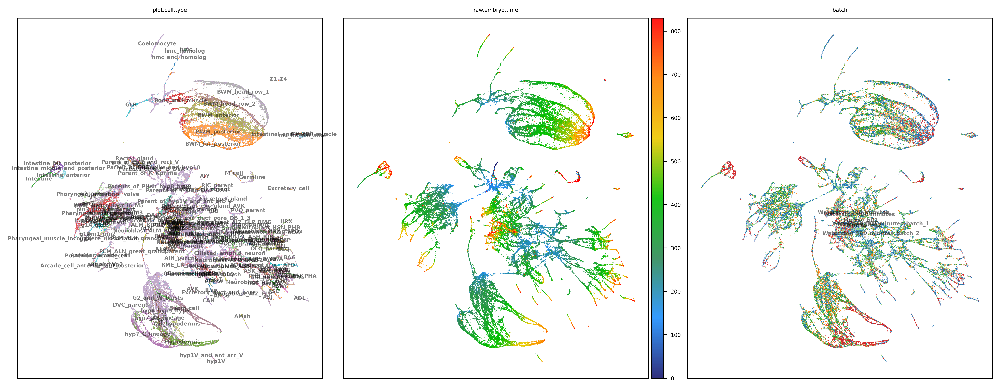

In [ ]:
basis = 'Concord'
#basis = 'X_concord_warmup'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['plot.cell.type', 'raw.embryo.time', "batch"]
pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = pal,
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [44]:
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
import plotly.io as pio
pio.renderers.default = 'notebook'
for col in show_cols:
    show_basis = f'{basis}_UMAP_3D'
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal[col],
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000
        )

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP_3D']


In [11]:
adata.write_h5ad(data_dir / f"{proj_name}_{file_suffix}.h5ad") # Save the adata object with the encoded embeddings
print(f"Saved adata to {data_dir / f'{proj_name}_{file_suffix}.h5ad'}")

Saved adata to ../data/celegans_data/concord_celegans_Jun17-1944.h5ad
